In [1]:
# Import the os module
import os

# Get the current working directory
cwd = os.getcwd()

# Print the current working directory
print("Current working directory: {0}".format(cwd))

# Print the type of the returned object
print("os.getcwd() returns an object of type: {0}".format(type(cwd)))

Current working directory: /home/jovyan/3_ALI-SARS/github_notebooks_submitted
os.getcwd() returns an object of type: <class 'str'>


In [2]:
os.chdir('/home/jovyan/ALI-SARS/pdf_plots/figures/')

In [2]:
import scanpy as sc
import numpy as np
import scanpy as sc
import pandas as pd
import seaborn as sns
import sctk as sk
sc.settings.verbosity = 3
import matplotlib.pyplot as plt
from matplotlib import rcParams
from matplotlib import colors

In [3]:
import session_info
session_info.show()

In [5]:
adata = sc.read('/home/jovyan/ALI-SARS/adata_for_fig2.h5ad')

In [6]:
adata

AnnData object with n_obs × n_vars = 139598 × 2667
    obs: 'sample', 'treatment', 'time', 'pool', 'sample_name', 'kit_version', 'spike-in_primer', 'batch', 'scrublet_leiden', 'scrublet_score', 'cluster_scrublet_score', 'doublet_pval', 'doublet_bh_pval', 'doublet', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'souporcell_cluster', 'donor_id', 'age_group', 'gender', 'processing', 'annotation_v2', 'annotation_v1', 'Cell_type_annotation_level3', 'Cell_type_annotation_level3_prob', 'predicted_labels', 'majority_voting', 'conf_score', 'S_score', 'G2M_score', 'phase', 'bbknn_batch', 'annotation_v3', 'annotation_v4', 'leiden_1', 'leiden_1.2', 'leiden_0.6', 'annotation_v5', 'leiden_R', 'ziegler_predicted_labels', 'ziegler_over_clustering', 'ziegler_majority_voting', 'ziegler_conf_score', 'score_HILLOCK'
    var: 'gene_ids', 'n_counts', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'ribo', '

In [7]:
adata.obs['age_group'].cat.reorder_categories(['Paediatric', 'Adult', 'Elderly'], inplace=True)

# IFN and basaloid scores

In [37]:
sc.set_figure_params(figsize=(6, 6))
plt.rcParams.update({'xtick.labelsize': 12, 'ytick.labelsize': 12})
import seaborn as sns
sns.set_theme(style='white')

In [38]:
#Calculate IFN_ALPHA SCORE
IFN_ALPHA_genes = [x.strip() for x in open("/nfs/team205/nh3/data/feature_lists/GOBP_RESPONSE_TO_INTERFERON_ALPHA_geneset.txt")]
IFN_ALPHA_genes

['#GOBP_RESPONSE_TO_INTERFERON_ALPHA',
 '#> Any process that results in a change in state or activity of a cell or an organism (in terms of movement, secretion, enzyme production, gene expression, etc.) as a result of an interferon-alpha stimulus. Interferon-alpha is a type I interferon. [GOC:sl, PMID:11356686]',
 'ADAR',
 'AXL',
 'BST2',
 'EIF2AK2',
 'GAS6',
 'GATA3',
 'IFIT2',
 'IFIT3',
 'IFITM1',
 'IFITM2',
 'IFITM3',
 'IFNAR1',
 'IFNAR2',
 'KLHL20',
 'LAMP3',
 'MX2',
 'PDE12',
 'PYHIN1',
 'RO60',
 'STAR',
 'TPR']

In [39]:
sc.tl.score_genes(adata, IFN_ALPHA_genes, score_name="score_IFN_alpha")

computing score 'score_IFN_alpha'
    finished: added
    'score_IFN_alpha', score of gene set (adata.obs).
    599 total control genes are used. (0:00:05)


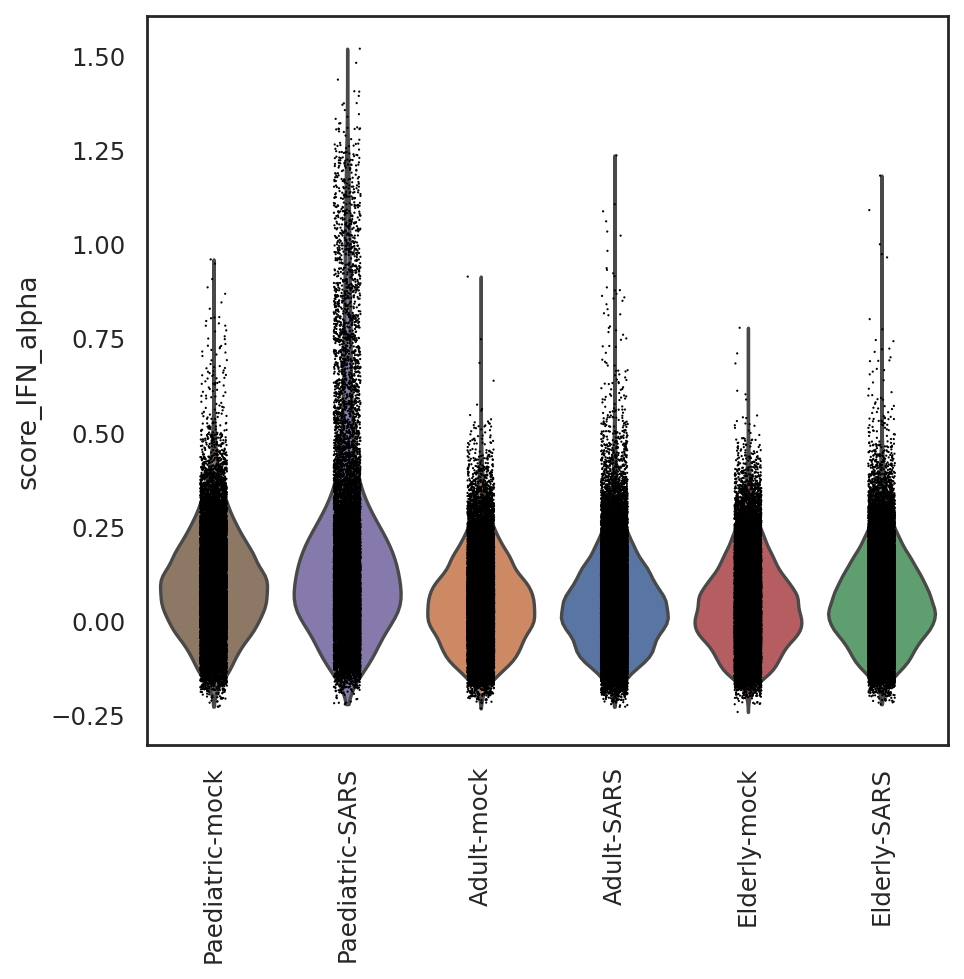

In [43]:
sc.pl.violin(adata, 'score_IFN_alpha', groupby='age_treatment', 
            order = ['Paediatric-mock', 'Paediatric-SARS','Adult-mock','Adult-SARS','Elderly-mock', 'Elderly-SARS'],  
            rotation=90, save = 'supp4a.pdf')

computing score 'score_IFN_gamma'
    finished: added
    'score_IFN_gamma', score of gene set (adata.obs).
    1188 total control genes are used. (0:00:05)


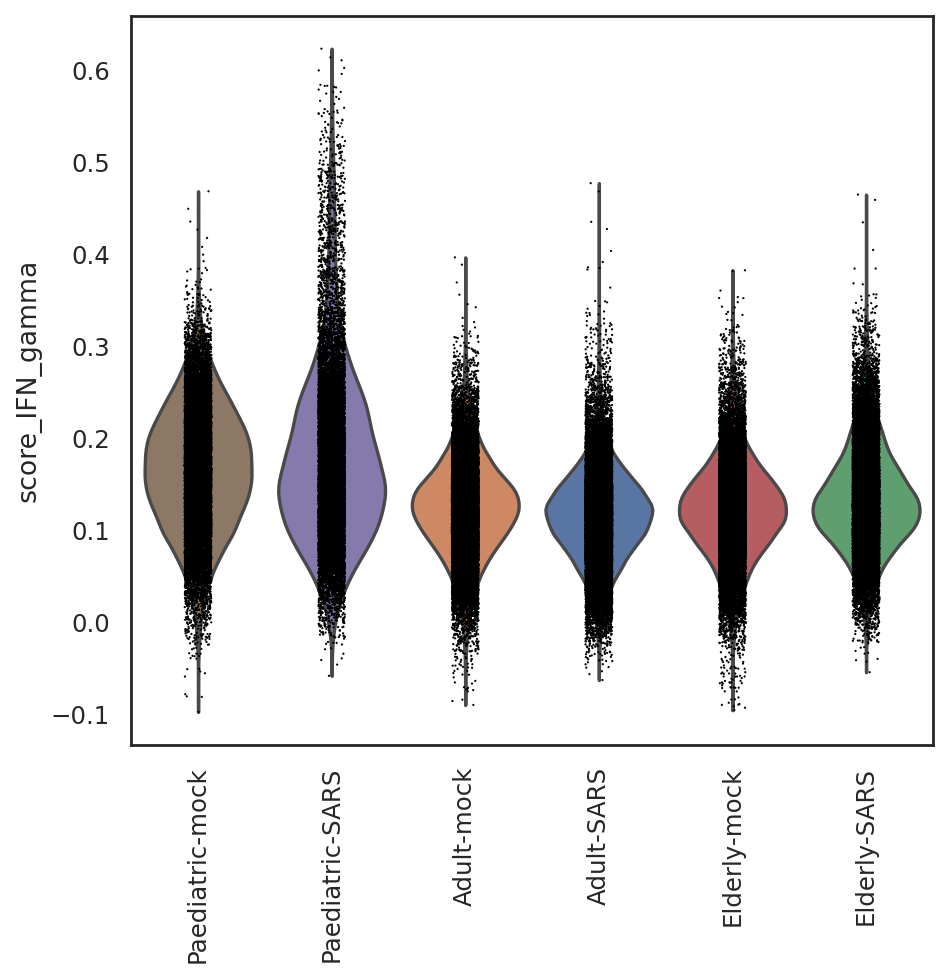

In [46]:
#Calculate IFN_ALPHA SCORE
IFN_GAMMA_genes = [x.strip() for x in open("/nfs/team205/nh3/data/feature_lists/GOBP_RESPONSE_TO_INTERFERON_GAMMA_geneset.txt")]
IFN_GAMMA_genes
sc.tl.score_genes(adata, IFN_GAMMA_genes, score_name="score_IFN_gamma")
sc.pl.violin(adata, 'score_IFN_gamma', groupby='age_treatment', 
            order = ['Paediatric-mock', 'Paediatric-SARS','Adult-mock','Adult-SARS','Elderly-mock', 'Elderly-SARS'],  
            rotation=90, save = 'supp4b.pdf')

computing score 'score_EMT'
    finished: added
    'score_EMT', score of gene set (adata.obs).
    899 total control genes are used. (0:00:05)


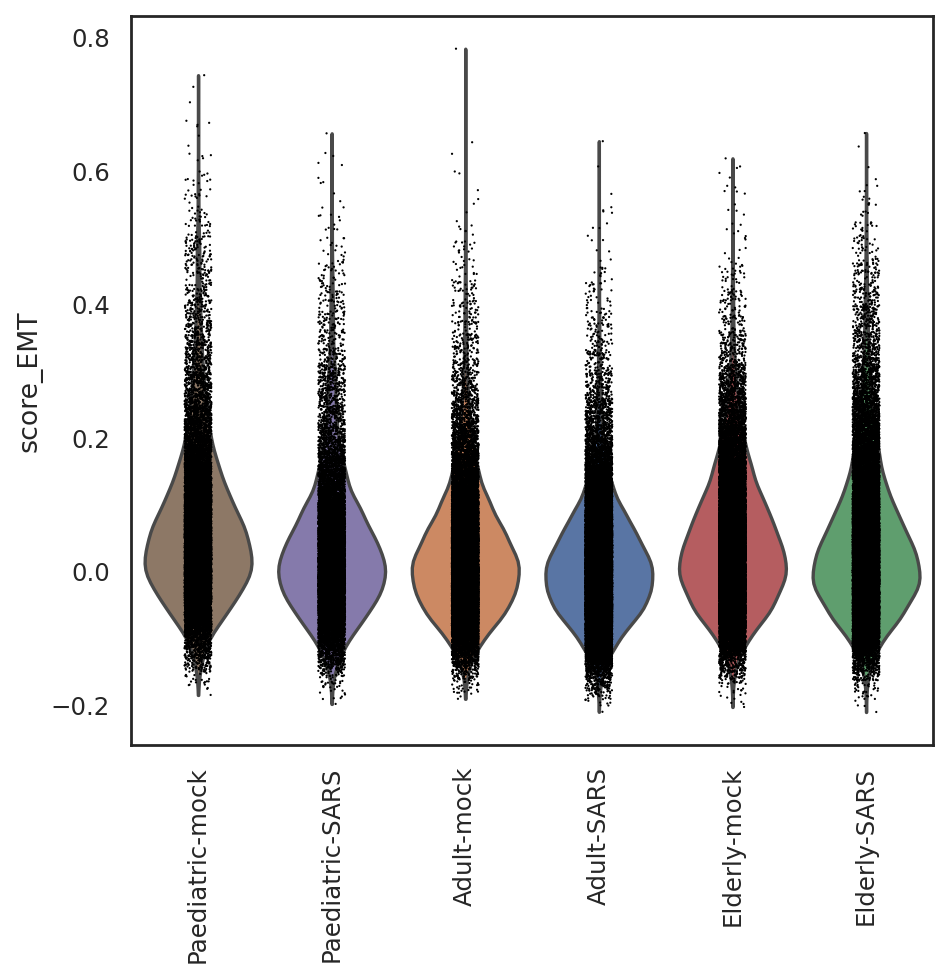

In [47]:
EMT_genes = ['SMAD3', 'SMAD2', 'CNN1', 'SNAI1', 'SNAI2', 'TWIST1', 'ABL1', 'IL1R2' ,'IL1R1' ,'NOS3' ,'NOTCH1', 'NOTCH3'
,'NOTCH4' ,'NFATC1' ,'GATA4' ,'TGFBR1','TGFBR2' ,'ACVRL1' ,'TCF3' ,'PI3KCA','GRB2' ,'MKL1' ,'CDH2' ,'HMGA1' ,'HIF1A' ,'TEK' ,'MTOR'
,'SP1' ,'SRF' ,'EDNRA' ,'EDNRB' ,'LEF1' ,'ZEB1', 'VIM', 'FN1', 'COL1A1', 'COL3A1', 'LAMA5'] 
sc.tl.score_genes(adata, EMT_genes, score_name="score_EMT")
sc.pl.violin(adata, 'score_EMT', groupby='age_treatment', 
            order = ['Paediatric-mock', 'Paediatric-SARS','Adult-mock','Adult-SARS','Elderly-mock', 'Elderly-SARS'],  
            rotation=90)

computing score 'score_BASALOID'
    finished: added
    'score_BASALOID', score of gene set (adata.obs).
    799 total control genes are used. (0:00:05)


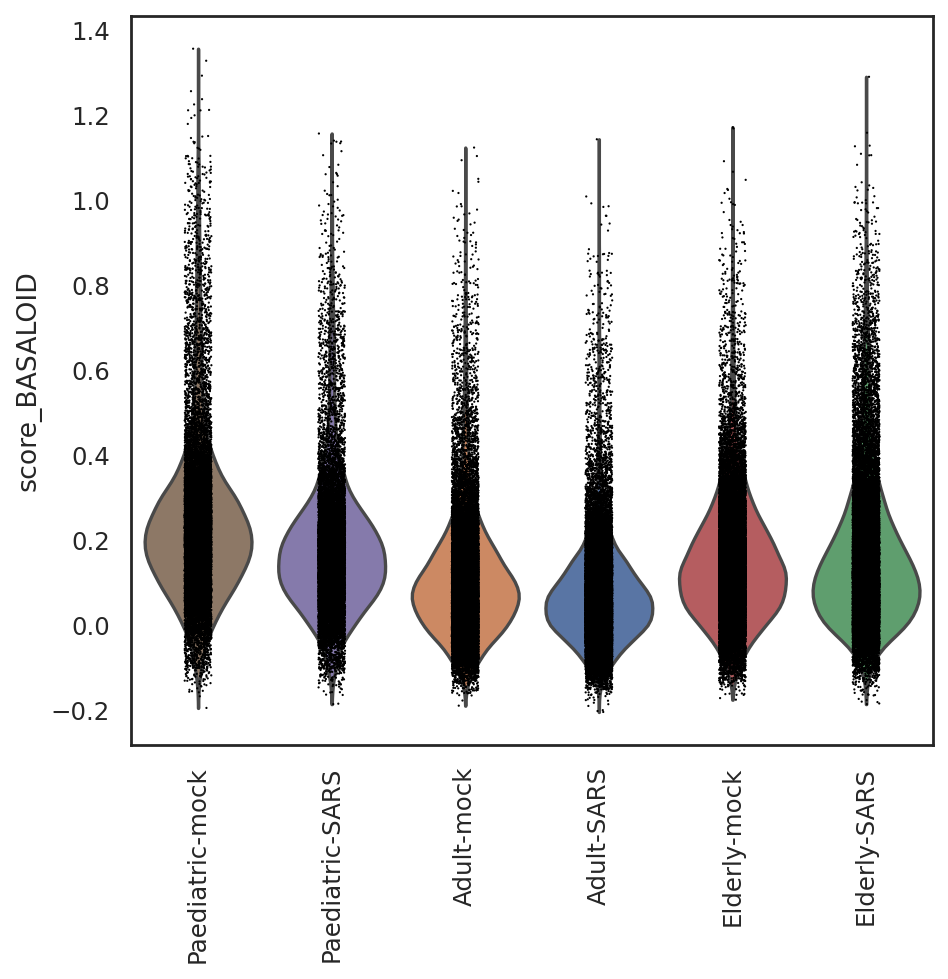

In [48]:
BASALOID = ['EPCAM', 'CDH1', 'VIM', 'FN1', 'COL1A1', 'CDH2', 'TNC', 'VCAN', 'PCP4','CUX2','SPINK1','PRSS2','CPA6','CTSE',
'MMP7','MDK','GDF15','PTGS2','SLCO2A1','EPHB2','ITGB8','ITGAV','ITGB6','TGFB1','KCNN4','KCNQ5','KCNS3','CDKN1A','CDKN2A','CDKN2B','CCND1','CCND2','MDM2','HMGA2','PTCHD4','OCIAD2']
sc.tl.score_genes(adata, BASALOID, score_name="score_BASALOID")
sc.pl.violin(adata, 'score_BASALOID', groupby='age_treatment', 
            order = ['Paediatric-mock', 'Paediatric-SARS','Adult-mock','Adult-SARS','Elderly-mock', 'Elderly-SARS'],  
            rotation=90, save = 'supp5b.pdf')

In [49]:
sc.set_figure_params(figsize=(14, 4))
import seaborn as sns
sns.set_theme(style='white')

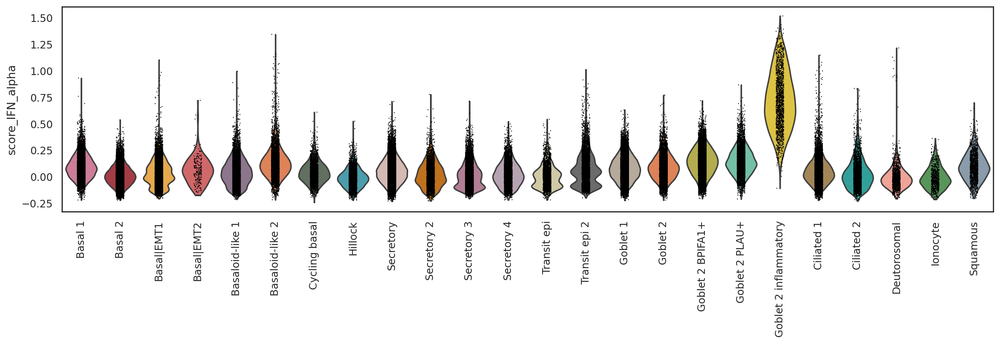

In [54]:
sc.pl.violin(adata, 'score_IFN_alpha', groupby='annotation_v5',
            rotation=90, save = '4a1.pdf')

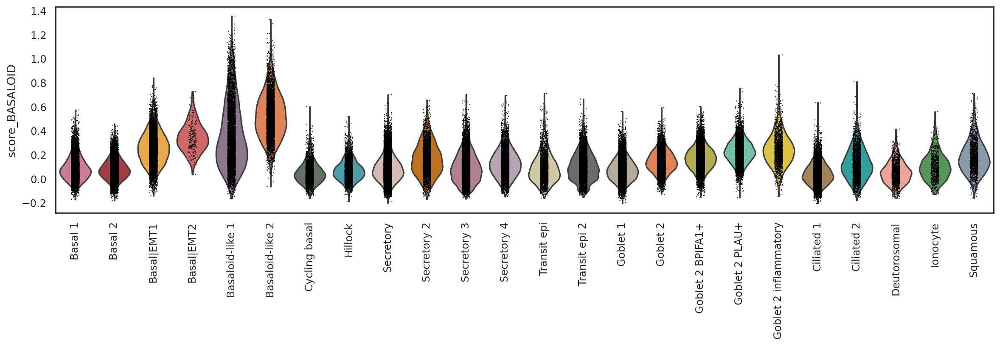

In [51]:
sc.pl.violin(adata, 'score_BASALOID', groupby='annotation_v5',
            rotation=90, save = 'supp5b1.pdf')

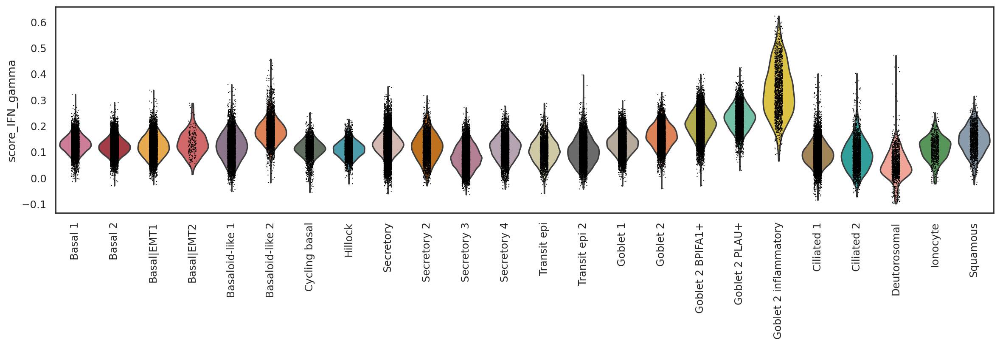

In [55]:
sc.pl.violin(adata, 'score_IFN_gamma', groupby='annotation_v5',
            rotation=90, save = '4a2.pdf')

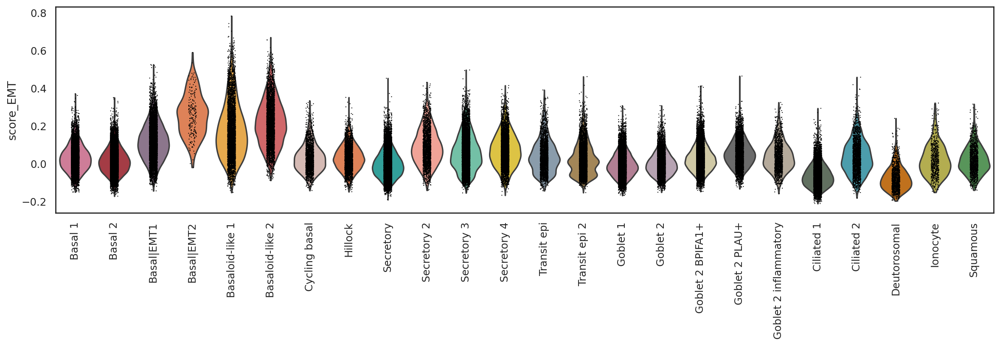

In [145]:
sc.pl.violin(adata, 'score_EMT', groupby='annotation_v5', 
            rotation=90)

# Dotplot pet total cell numbers

In [2]:
# Import the os module
import os

# Get the current working directory
cwd = os.getcwd()

# Print the current working directory
print("Current working directory: {0}".format(cwd))

# Print the type of the returned object
print("os.getcwd() returns an object of type: {0}".format(type(cwd)))

Current working directory: /home/jovyan/ALI-SARS
os.getcwd() returns an object of type: <class 'str'>


In [3]:
os.chdir('/home/jovyan/ALI-SARS/pdf_plots/figures/')

In [4]:
import scanpy as sc
import numpy as np
import scanpy as sc
import pandas as pd
import seaborn as sns
import sctk as sk
sc.settings.verbosity = 3
import matplotlib.pyplot as plt
from matplotlib import rcParams
from matplotlib import colors

In [5]:
sc.settings.set_figure_params(dpi=100, dpi_save=300)

In [6]:
adata = sc.read_h5ad('/home/jovyan/ALI-SARS/adata.annotation_v5_paper_object.h5ad')

In [10]:
arr = np.array(['Paediatric-mock', 'Adult-mock', 'Elderly-mock'])

In [11]:
print(np.sort(arr))

['Adult-mock' 'Elderly-mock' 'Paediatric-mock']


In [12]:
arr2 = np.array(['Basal 1', 'Basal 2', 'Basal|EMT1', 'Basal|EMT2', 'Basaloid-like 1',
       'Basaloid-like 2', 'Cycling basal', 'Hillock','Secretory', 'Secretory 2',
       'Secretory 3', 'Secretory 4', 'Transit epi', 'Transit epi 2' ,'Goblet 1',
       'Goblet 2', 'Goblet 2 BPIFA1+', 'Goblet 2 PLAU+',
       'Goblet 2 inflammatory','Ciliated 1',
       'Ciliated 2', 'Deutorosomal', 'Ionocyte', 'Squamous'])

In [13]:
import anndata
import pandas as pd
import scanpy as sc
import numpy as np
from matplotlib.axes import Axes

from scanpy.pl._dotplot import DotPlot

class DotPlotHack(DotPlot):
    def _plot_size_legend(self, size_legend_ax: Axes):
        # for the dot size legend, use step between dot_max and dot_min
        # based on how different they are.
        diff = self.dot_max - self.dot_min
        if 0.3 < diff <= 0.6:
            step = 0.1
        elif diff <= 0.3:
            step = 0.05
        else:
            #HACK TIME
            #make four evenly spaced dots, so diff/3 apart
            step = np.ceil(diff/3)
        # a descending range that is afterwards inverted is used
        # to guarantee that dot_max is in the legend.
        #HACK TIME
        #3*step may be more than the max, so compute a new "max"
        size_range = np.arange(self.dot_min + 3*step, self.dot_min, step * -1)[::-1]
        if self.dot_min != 0 or self.dot_max != 1:
            dot_range = self.dot_max - self.dot_min
            size_values = (size_range - self.dot_min) / dot_range
        else:
            size_values = size_range

        size = size_values**self.size_exponent
        size = size * (self.largest_dot - self.smallest_dot) + self.smallest_dot

        # plot size bar
        size_legend_ax.scatter(
            np.arange(len(size)) + 0.5,
            np.repeat(0, len(size)),
            s=size,
            color='gray',
            edgecolor='black',
            linewidth=self.dot_edge_lw,
            zorder=100,
        )
        size_legend_ax.set_xticks(np.arange(len(size)) + 0.5)
        #HACK TIME
        #removed the percentage from this
        labels = [
            "{}".format(np.round(x, decimals=0).astype(int)) for x in size_range
        ]
        size_legend_ax.set_xticklabels(labels, fontsize='small')

        # remove y ticks and labels
        size_legend_ax.tick_params(
            axis='y', left=False, labelleft=False, labelright=False
        )

        # remove surrounding lines
        size_legend_ax.spines['right'].set_visible(False)
        size_legend_ax.spines['top'].set_visible(False)
        size_legend_ax.spines['left'].set_visible(False)
        size_legend_ax.spines['bottom'].set_visible(False)
        size_legend_ax.grid(False)

        ymax = size_legend_ax.get_ylim()[1]
        size_legend_ax.set_ylim(-1.05 - self.largest_dot * 0.003, 4)
        size_legend_ax.set_title(self.size_title, y=ymax + 0.45, size='small')

        xmin, xmax = size_legend_ax.get_xlim()
        size_legend_ax.set_xlim(xmin - 0.15, xmax + 0.5)

def dotplot_2obs(adata, gene, x_axis, y_axis, x_order=None, y_order=None, return_fig=False):
    """
    A function that extracts the expression for a provided gene, 
    and subsequently prepares a dotplot where the two axes are 
    two categoricals from the obs of the object.
    
    Assumes expression data as a sparse matrix in adata.raw
    """
    #prepare dfs with dot sizes and colours
    #start off by making a helper df with all the info
    obs_tidy_master = adata.obs[[y_axis,x_axis]].set_index(y_axis)
    #add gene expression. TODO: not just sparse raw?
    obs_tidy_master[gene] = adata.raw[:,gene].X.todense()
    #this is where our computed values will go
    dot_size_df = pd.DataFrame(0, index=np.unique(obs_tidy_master.index), columns = np.unique(obs_tidy_master[x_axis]))
    #reorder the groups if specified
    if x_order is not None:
        dot_size_df = dot_size_df[x_order]
    if y_order is not None:
        dot_size_df = dot_size_df.loc[y_order,:]
    dot_color_df = dot_size_df.copy()
    #compute the sizes and colors, replicating the logic found within DotPlot()
    for cat in dot_size_df.columns:
        obs_tidy = obs_tidy_master.loc[obs_tidy_master[x_axis]==cat, gene]
        obs_bool = obs_tidy > 0
        dot_color_df[cat] = obs_tidy.groupby(level=0).mean().fillna(0)
        dot_size_df[cat] = obs_bool.groupby(level=0).sum()
    #in order to actually plot this, we need to make a dummy anndata object
    #just how DotPlot() is wired internally
    bdata = anndata.AnnData(np.zeros(dot_size_df.shape))
    bdata.var_names = dot_size_df.columns
    #this needs to be turned to a list or it whines about a conflict later
    bdata.obs_names = list(dot_size_df.index)
    #the grouping variable needs to be present in the dummy object
    #its existence is checked, it actually does nothing when we insert the dot sizes
    bdata.obs[y_axis] = dot_size_df.index
    #actually make the dotplot, with the best colour scheme :P
    dp = DotPlotHack(bdata, dot_size_df.columns, y_axis, dot_size_df=dot_size_df, dot_color_df=dot_color_df, title=gene)
    dp = dp.style(cmap='OrRd')
    dp.size_title = "Number of cells\nin group"
    dp.make_figure()

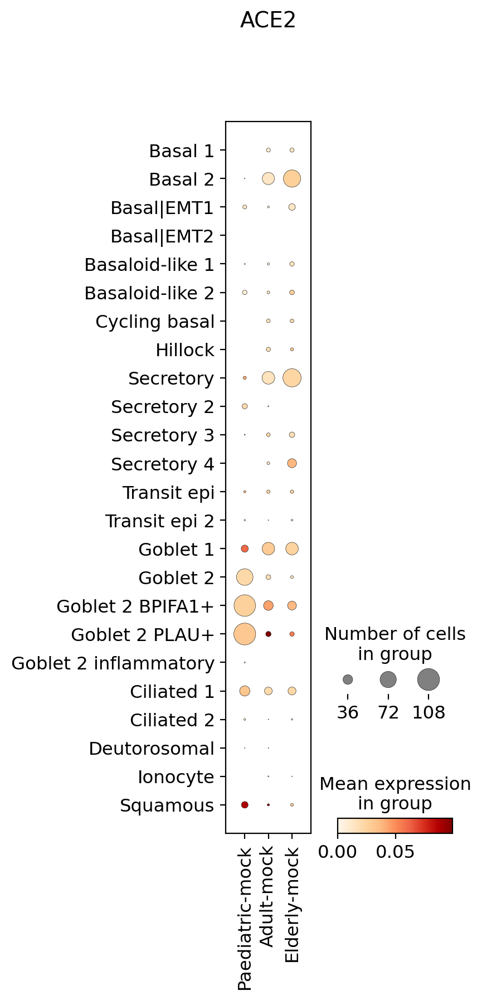

In [18]:
dotplot_2obs(adata, gene="ACE2", x_axis="age_treatment", 
             y_axis="annotation_v5", x_order=arr, y_order=arr2)
plt.savefig('1j1.pdf', bbox_inches = 'tight')

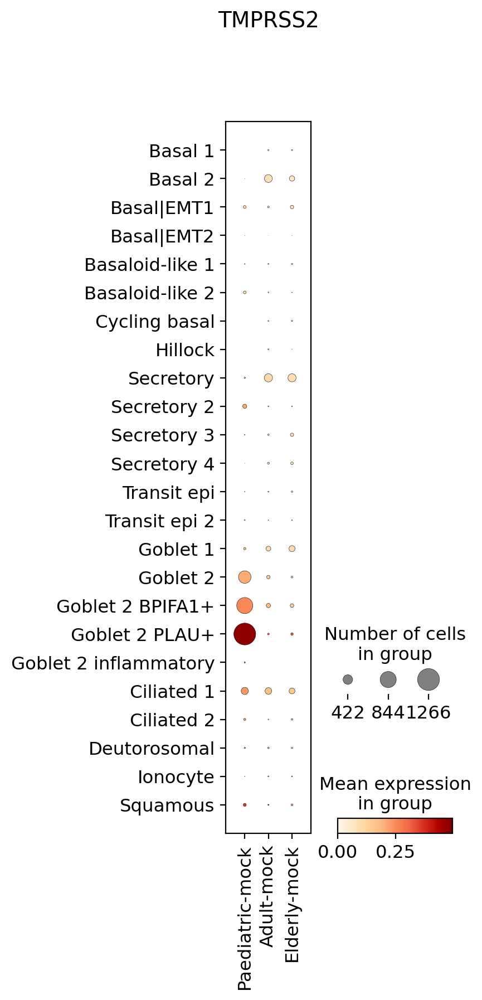

In [19]:
dotplot_2obs(adata, gene="TMPRSS2", x_axis="age_treatment", 
             y_axis="annotation_v5", x_order=arr, y_order=arr2)
plt.savefig('1j2.pdf', bbox_inches = 'tight')

In [20]:
arr = np.array(['Paediatric-mock', 'Paediatric-SARS', 'Adult-mock', 'Adult-SARS','Elderly-mock', 'Elderly-SARS' ])

In [21]:
print(np.sort(arr))

['Adult-SARS' 'Adult-mock' 'Elderly-SARS' 'Elderly-mock' 'Paediatric-SARS'
 'Paediatric-mock']


In [22]:
arr2 = np.array(['Basal 1', 'Basal 2', 'Basal|EMT1', 'Basal|EMT2', 'Basaloid-like 1',
       'Basaloid-like 2', 'Cycling basal', 'Hillock','Secretory', 'Secretory 2',
       'Secretory 3', 'Secretory 4', 'Transit epi', 'Transit epi 2' ,'Goblet 1',
       'Goblet 2', 'Goblet 2 BPIFA1+', 'Goblet 2 PLAU+',
       'Goblet 2 inflammatory','Ciliated 1',
       'Ciliated 2', 'Deutorosomal', 'Ionocyte', 'Squamous'])

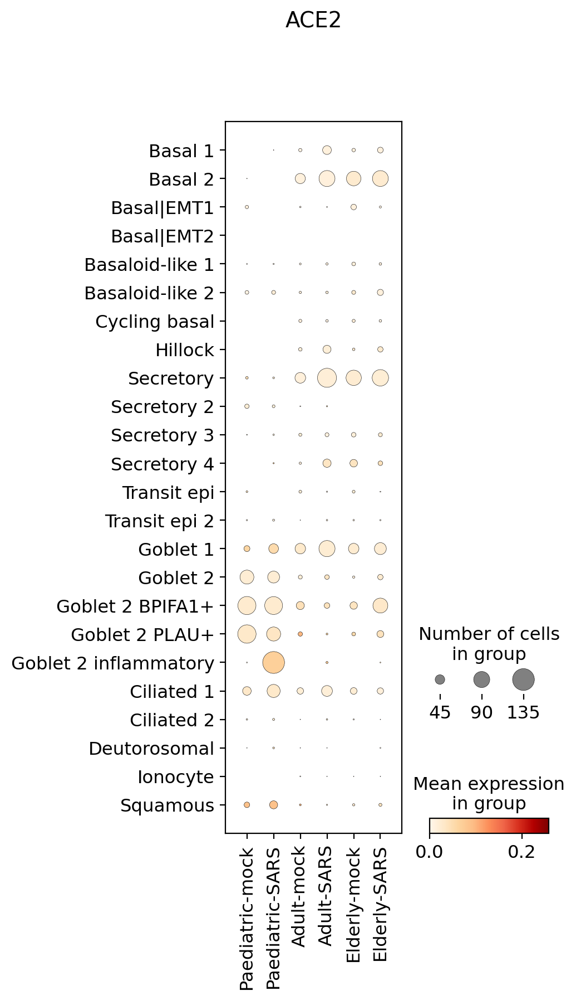

In [23]:
dotplot_2obs(adata, gene="ACE2", x_axis="age_treatment", 
             y_axis="annotation_v5", x_order=arr, y_order=arr2)
plt.savefig('4e1.pdf', bbox_inches = 'tight')

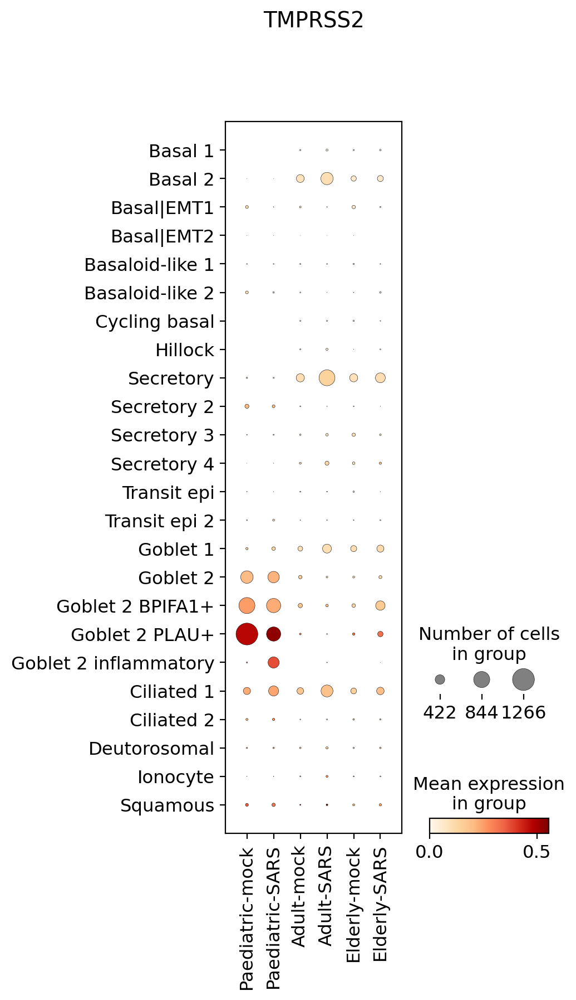

In [24]:
dotplot_2obs(adata, gene="TMPRSS2", x_axis="age_treatment", y_axis="annotation_v5", 
             x_order=arr, y_order=arr2)
plt.savefig('4e2.pdf', bbox_inches = 'tight')

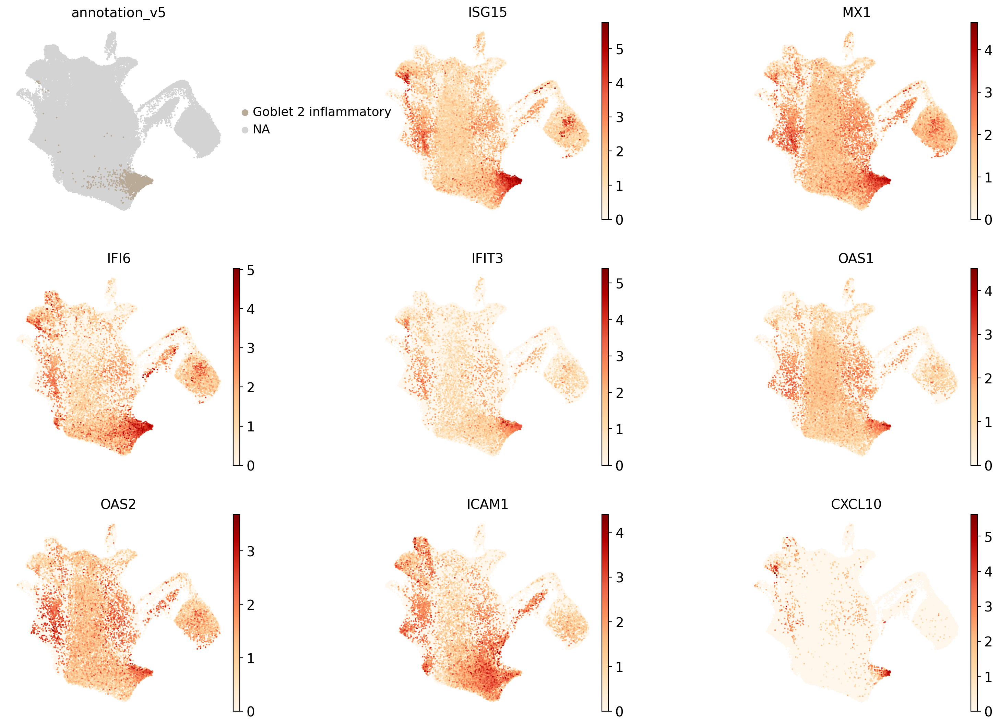

In [42]:
sc.settings.set_figure_params(dpi=100, dpi_save=300)
sc.pl.umap(
    adata,            
    color = ['annotation_v5','ISG15', 'MX1', 'IFI6', 
             'IFIT3', 'OAS1', 'OAS2', 'ICAM1', 'CXCL10'], 
    groups = 'Goblet 2 inflammatory', size = 10, 
    frameon = False, ncols = 3, cmap ='OrRd', wspace = 0.5)

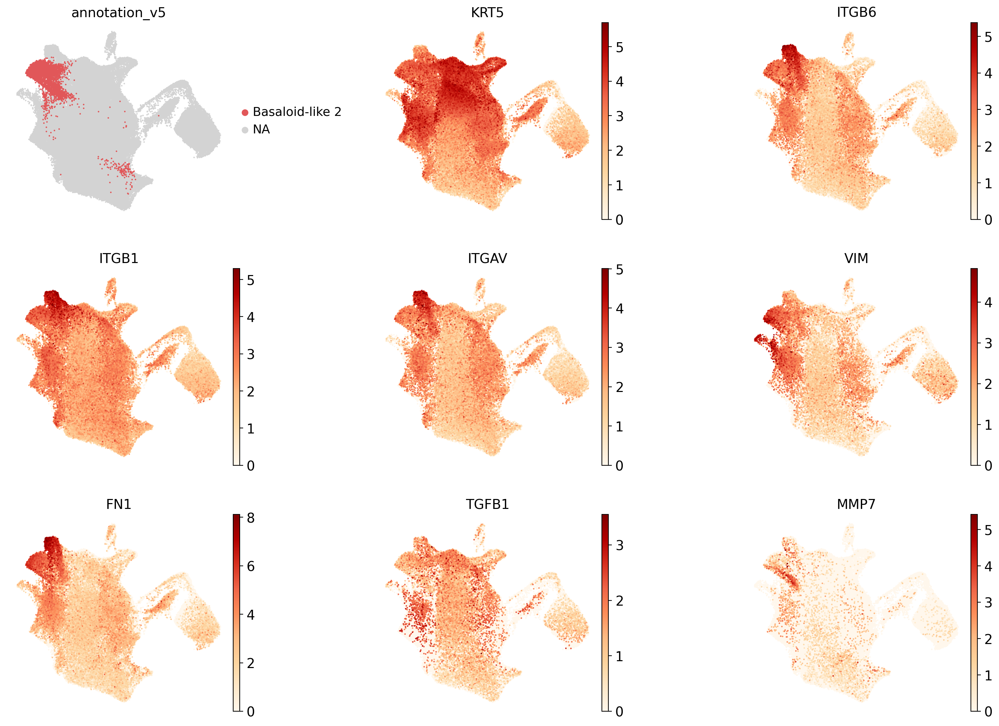

In [41]:
sc.settings.set_figure_params(dpi=100, dpi_save=300)
sc.pl.umap(
    adata,            
    color = ['annotation_v5','KRT5', 'ITGB6', 'ITGB1', 
             'ITGAV', 'VIM', 'FN1','TGFB1', 'MMP7'], 
    groups = 'Basaloid-like 2', size = 10, frameon = False, 
    ncols = 3, cmap ='OrRd', wspace = 0.5)

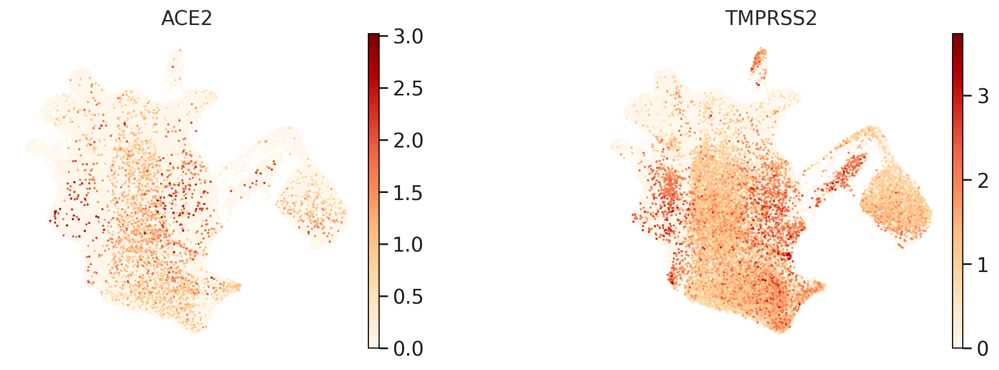

In [20]:
sc.settings.set_figure_params(dpi=100, dpi_save=300)
sc.pl.umap(
    adata,            
    color = ['ACE2', 'TMPRSS2'], 
    size = 10, frameon = False, 
    ncols = 3, cmap ='OrRd', wspace = 0.5, save = '1i.pdf')

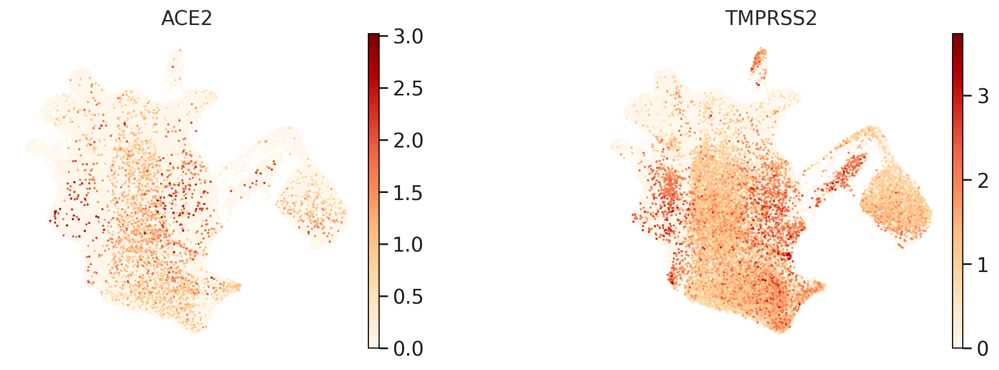

In [21]:
sc.settings.set_figure_params(dpi=100, dpi_save=300)
sc.pl.umap(
    adata,            
    color = ['ACE2', 'TMPRSS2'], 
    size = 10, frameon = False, 
    ncols = 3, cmap ='OrRd', wspace = 0.5, save = '1i.png')

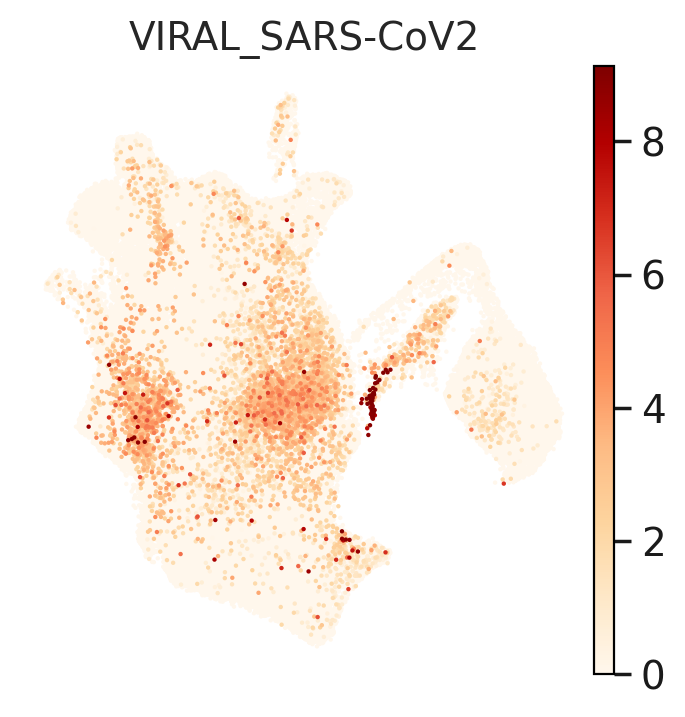

In [22]:
sc.settings.set_figure_params(dpi=100, dpi_save=300)
sc.pl.umap(
    adata,            
    color = ['VIRAL_SARS-CoV2'], 
    size = 10, frameon = False, 
    ncols = 3, cmap ='OrRd', wspace = 0.5, save='2c.pdf')

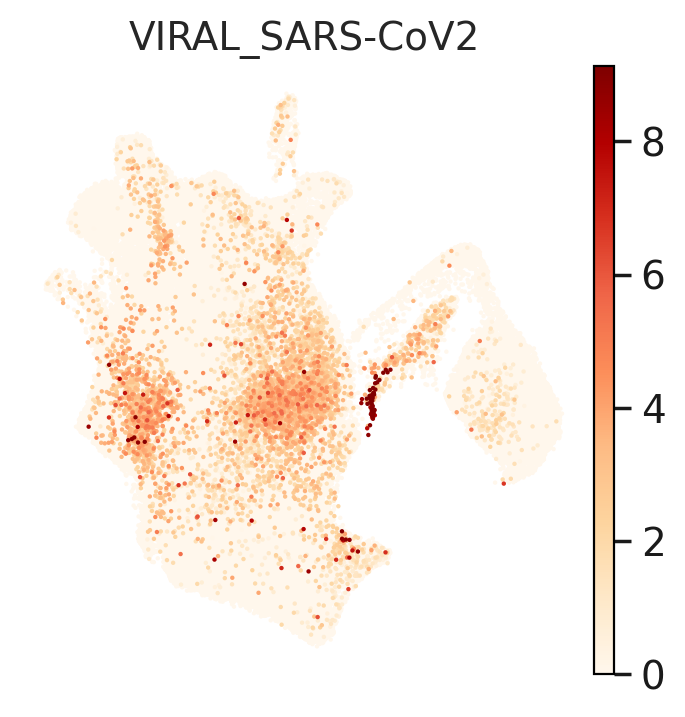

In [23]:
sc.settings.set_figure_params(dpi=100, dpi_save=300)
sc.pl.umap(
    adata,            
    color = ['VIRAL_SARS-CoV2'], 
    size = 10, frameon = False, 
    ncols = 3, cmap ='OrRd', wspace = 0.5, save='2c.png')

# QC extended figures

In [7]:
plt.rcParams.update({'xtick.labelsize': 12, 'ytick.labelsize': 12})
import seaborn as sns
sns.set_theme(style='white')

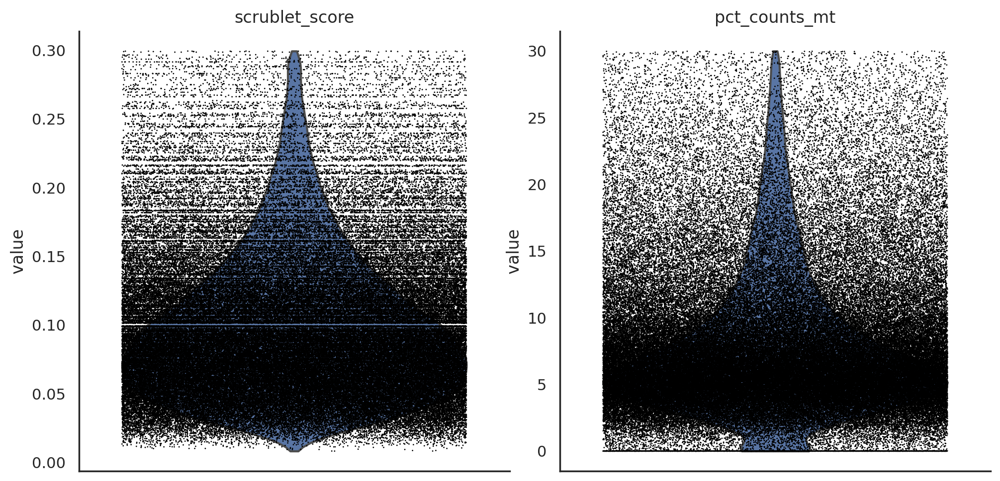

In [19]:
sc.pl.violin(adata, ['scrublet_score', 'pct_counts_mt' ],
             jitter=0.4, ncols =1, multi_panel=True, save='supp1d.pdf')

In [15]:
adata.uns['age_group_colors'][0] = 'lightblue'
adata.uns['age_group_colors'][2] = 'tan'
adata.uns['age_group_colors'][1] = 'darkseagreen'

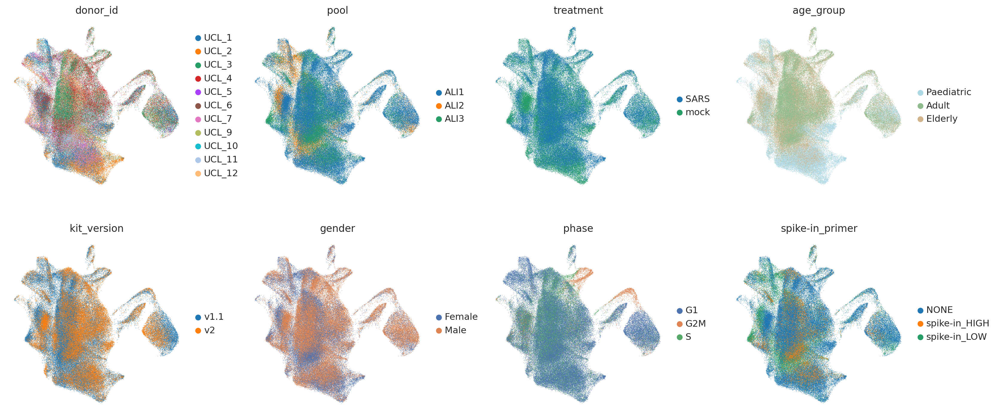

In [17]:
sc.pl.umap(
    adata,
    color = ['donor_id', 'pool', 'treatment','age_group', 
             'kit_version',  'gender', 'phase', 'spike-in_primer'], frameon= False, ncols = 4, save='supp1e.pdf')

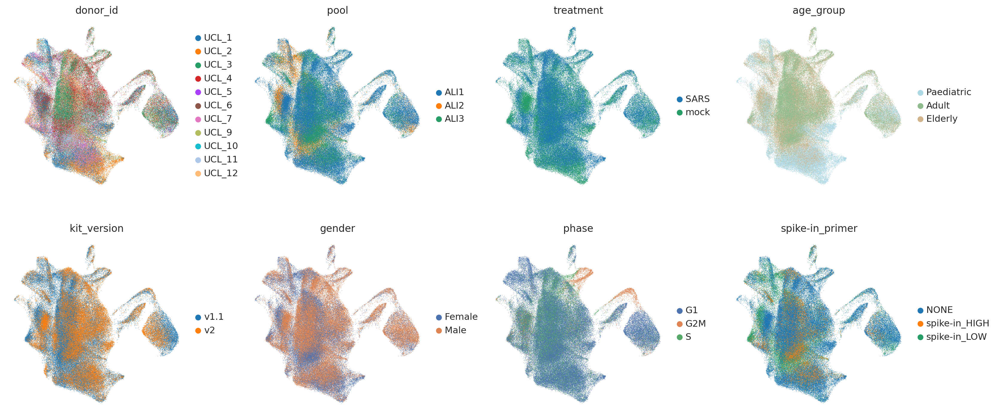

In [18]:
sc.pl.umap(
    adata,
    color = ['donor_id', 'pool', 'treatment','age_group', 
             'kit_version',  'gender', 'phase', 'spike-in_primer'], frameon= False, ncols = 4, save='supp1e.png')

# Celltypist predictions

In [43]:
import celltypist

In [ ]:
#Predict the identity of each input cell with the new model.
predictions = celltypist.annotate(adata, model = '/home/jovyan/ALI-SARS/celltypist_model_ziegler.pkl', majority_voting = True)
predictions

👀 Invalid expression matrix in `.X`, expect log1p normalized expression to 10000 counts per cell; will try the `.raw` attribute
🔬 Input data has 139598 cells and 26447 genes
🔗 Matching reference genes in the model
🧬 26074 features used for prediction
⚖️ Scaling input data


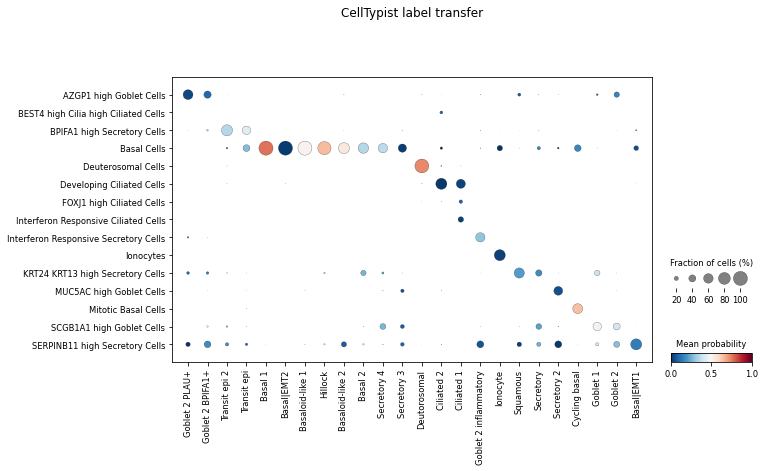

In [8]:
celltypist.dotplot(predictions, use_as_reference = 'annotation_v5', use_as_prediction = 'majority_voting')

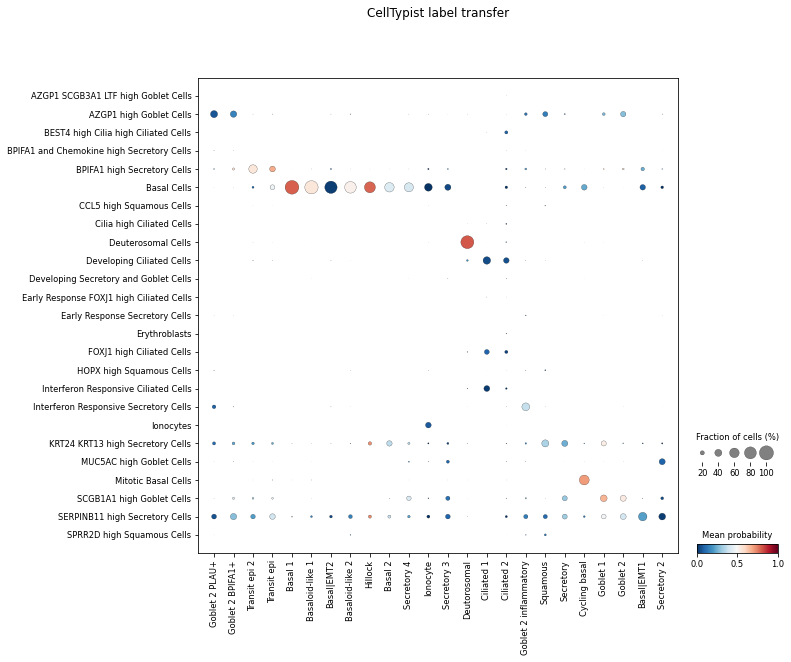

In [9]:
celltypist.dotplot(predictions, use_as_reference = 'annotation_v5', use_as_prediction = 'predicted_labels')

In [10]:
#Predict the identity of each input cell with the new model.
predictions = celltypist.annotate(adata, model = '/home/jovyan/ALI-SARS/celltypist/celltypist_model.pkl', majority_voting = True)
predictions

👀 Detected scaled expression in the input data, will try the .raw attribute
🔬 Input data has 139598 cells and 26447 genes
🔗 Matching reference genes in the model
🧬 1485 features used for prediction
⚖️ Scaling input data
🖋️ Predicting labels
✅ Prediction done!
👀 Detected a neighborhood graph in the input object, will run over-clustering on the basis of it
⛓️ Over-clustering input data with resolution set to 25


running Leiden clustering
    finished: found 368 clusters and added
    'over_clustering', the cluster labels (adata.obs, categorical) (0:02:14)


🗳️ Majority voting the predictions
✅ Majority voting done!


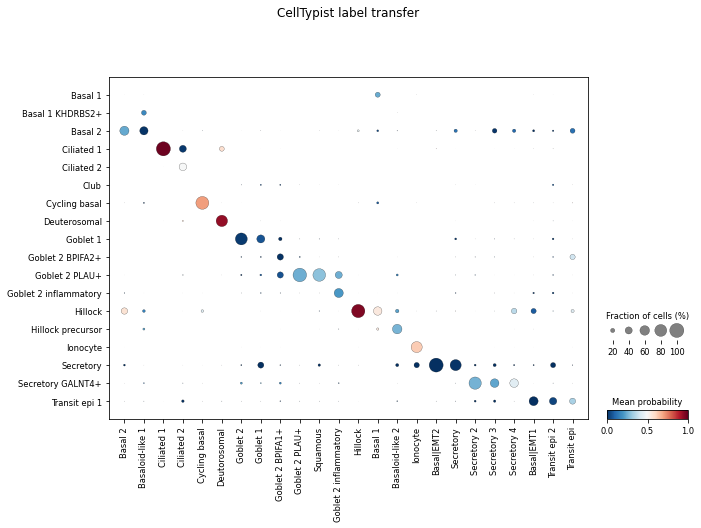

In [11]:
celltypist.dotplot(predictions, use_as_reference = 'annotation_v5', use_as_prediction = 'majority_voting')

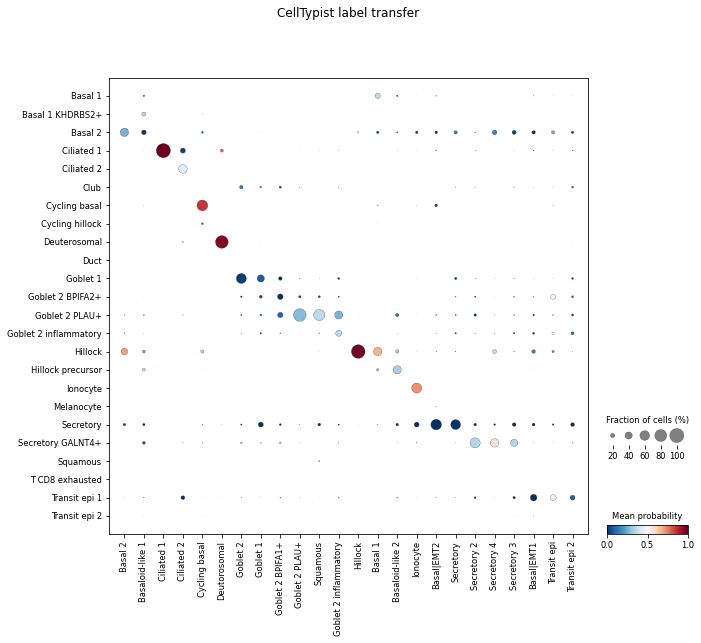

In [12]:
celltypist.dotplot(predictions, use_as_reference = 'annotation_v5', use_as_prediction = 'predicted_labels')